In [1]:
scvi = '/Users/aumchampaneri/Complement-OUD/Multi-Omics Study/data/processed/snrna_scvi/GSE225158_annotated_scvi.h5ad'

# Load the scVI data
import scanpy as sc
import pandas as pd
import os

adata = sc.read_h5ad(scvi)

# UMAP Visualizations for Single-Cell RNA-seq Data

## Overview
This notebook generates comprehensive UMAP visualizations for metadata variables, cell types, and quality control metrics following Nature figure best practices.

## Features
- **Custom Color Palette**: 15-color palette optimized for publication figures
- **Publication Ready**: 300 DPI, vector formats (PNG & PDF), Helvetica font
- **Comprehensive Analysis**: Metadata, cell types, and QC metrics
- **Statistical Annotations**: Mean, standard deviation, counts, and proportions

## Target Variables
1. **Sex** - Categorical visualization with distinct colors
2. **OUD Diagnosis** - Categorical visualization showing diagnostic groups  
3. **Age** - Continuous visualization with color gradient
4. **UMI Counts** - Continuous visualization showing expression distribution
5. **Cell Types** - Categorical visualization of annotated cell populations
6. **QC Metrics** - Continuous visualizations of quality control parameters

## Color Palette
- **Black (#000000)** - Borders, text, axes
- **Blues** - Light (#B6DBFF), Medium (#7BB0DF), Dark (#1964B0)
- **Teals** - Teal (#00C992), Dark Teal (#008A69)
- **Greens** - Dark Green (#386350)
- **Yellows/Oranges** - Yellow (#E9DC6D), Orange (#F4A637), Red-Orange (#DB5829)
- **Browns** - Brown (#894B45)
- **Purples** - Light (#D2BBD7), Medium (#AE75A2), Dark (#882D71)
- **Gray** - Light Gray (#DEDEDE)

## Output Files
### Individual Variable UMAPs:
- `Figure_UMAP_SEX.png/pdf`
- `Figure_UMAP_OUD_DIAGNOSIS.png/pdf` 
- `Figure_UMAP_AGE.png/pdf`
- `Figure_UMAP_N_GENES_BY_COUNTS.png/pdf`

### Comprehensive Figures:
- `Figure_UMAP_Metadata_Comprehensive.png/pdf` - Multi-panel metadata overview
- `Figure_UMAP_CellTypes_Clean.png/pdf` - Publication-ready cell type UMAP
- `Figure_UMAP_QC_Metrics.png/pdf` - Quality control metrics overview
- `Figure_Metadata_Summary_Table.png/pdf` - Statistical summary table

## Requirements
- Python 3.7+
- scanpy, pandas, matplotlib, numpy
- Single-cell data with UMAP coordinates and metadata
- Helvetica font (for publication quality)

In [2]:
# UMAP VISUALIZATION SETUP
# ========================
# Custom color palette and publication-ready styling for Nature figures

import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import numpy as np
import pandas as pd
import warnings
warnings.filterwarnings('ignore')

# Custom color palette - exactly as specified
CUSTOM_PALETTE = [
    '#000000',  # Black - for borders, text, etc.
    '#B6DBFF',  # Light blue
    '#7BB0DF',  # Medium blue
    '#1964B0',  # Dark blue
    '#00C992',  # Teal
    '#008A69',  # Dark teal
    '#386350',  # Dark green
    '#E9DC6D',  # Yellow
    '#F4A637',  # Orange
    '#DB5829',  # Red-orange
    '#894B45',  # Brown
    '#D2BBD7',  # Light purple
    '#AE75A2',  # Medium purple
    '#882D71',  # Dark purple
    '#DEDEDE'   # Light gray
]

# Visualization colors (excluding black which is for borders/text)
VIZ_COLORS = CUSTOM_PALETTE[1:]  # All colors except black

# Configure Helvetica font and publication-ready settings
plt.rcParams.update({
    'font.family': 'Helvetica',  # Use Helvetica as requested
    'font.size': 10,
    'axes.linewidth': 0.8,
    'axes.spines.top': False,
    'axes.spines.right': False,
    'axes.edgecolor': '#000000',  # Black borders
    'axes.labelcolor': '#000000',  # Black text
    'text.color': '#000000',  # Black text
    'xtick.color': '#000000',  # Black tick marks
    'ytick.color': '#000000',  # Black tick marks
    'xtick.major.size': 3,
    'ytick.major.size': 3,
    'xtick.minor.size': 2,
    'ytick.minor.size': 2,
    'legend.frameon': False,
    'legend.edgecolor': '#000000',  # Black legend borders
    'figure.dpi': 300,
    'savefig.dpi': 300,
    'savefig.bbox': 'tight',
    'savefig.transparent': True,
    'pdf.fonttype': 42,  # Ensures fonts are embedded properly
    'ps.fonttype': 42
})

# Define named colors for consistent use
COLORS = {
    'black': CUSTOM_PALETTE[0],        # For borders, text, etc.
    'light_blue': CUSTOM_PALETTE[1],   # Light blue
    'medium_blue': CUSTOM_PALETTE[2],  # Medium blue  
    'dark_blue': CUSTOM_PALETTE[3],    # Dark blue
    'teal': CUSTOM_PALETTE[4],         # Teal
    'dark_teal': CUSTOM_PALETTE[5],    # Dark teal
    'dark_green': CUSTOM_PALETTE[6],   # Dark green
    'yellow': CUSTOM_PALETTE[7],       # Yellow
    'orange': CUSTOM_PALETTE[8],       # Orange
    'red_orange': CUSTOM_PALETTE[9],   # Red-orange
    'brown': CUSTOM_PALETTE[10],       # Brown
    'light_purple': CUSTOM_PALETTE[11], # Light purple
    'medium_purple': CUSTOM_PALETTE[12], # Medium purple
    'dark_purple': CUSTOM_PALETTE[13],  # Dark purple
    'light_gray': CUSTOM_PALETTE[14],   # Light gray
    
    # Aliases for backward compatibility
    'primary': CUSTOM_PALETTE[3],      # Dark blue
    'secondary': CUSTOM_PALETTE[12],   # Medium purple  
    'tertiary': CUSTOM_PALETTE[8],     # Orange
    'quaternary': CUSTOM_PALETTE[9],   # Red-orange
    'neutral': CUSTOM_PALETTE[0],      # Black
}

# Function to generate distinct colors for categories using custom palette
def generate_distinct_colors(n_colors, exclude_black=True):
    """Generate distinct colors using custom palette, excluding black by default"""
    colors_to_use = VIZ_COLORS if exclude_black else CUSTOM_PALETTE
    
    if n_colors <= len(colors_to_use):
        return colors_to_use[:n_colors]
    else:
        # If we need more colors than in palette, cycle through it
        colors = []
        for i in range(n_colors):
            colors.append(colors_to_use[i % len(colors_to_use)])
        return colors

# Set up scanpy to use custom palette
try:
    sc.settings.set_figure_params(
        dpi=300,
        dpi_save=300,
        vector_friendly=True,
        format='png',
        facecolor='white'
    )
    sc.settings.verbosity = 2
    print("✓ Scanpy configured with custom settings")
except:
    print("⚠ Scanpy configuration partially applied")

# Set output directory
output_dir = '/Users/aumchampaneri/Complement-OUD/Multi-Omics Study/figures/snrna/outputs'
os.makedirs(output_dir, exist_ok=True)

print("🎨 UMAP Visualization Setup Complete!")
print(f"✓ Custom color palette loaded ({len(CUSTOM_PALETTE)} colors)")
print(f"✓ Helvetica font configured")
print(f"✓ Publication-ready settings applied")
print(f"✓ Output directory: {output_dir}")
print(f"✓ Data shape: {adata.shape}")

✓ Scanpy configured with custom settings
🎨 UMAP Visualization Setup Complete!
✓ Custom color palette loaded (15 colors)
✓ Helvetica font configured
✓ Publication-ready settings applied
✓ Output directory: /Users/aumchampaneri/Complement-OUD/Multi-Omics Study/figures/snrna/outputs
✓ Data shape: (75942, 30527)


In [3]:
# COMPREHENSIVE METADATA UMAP VISUALIZATIONS
# ============================================
# Create publication-ready UMAP plots for sex, OUD diagnosis, age, and UMI counts
# Following Nature figure best practices with custom color palette

def create_metadata_umaps(adata, save_path):
    """
    Create comprehensive UMAP visualizations for key metadata variables
    """
    
    # Check if UMAP coordinates exist
    if 'X_umap' not in adata.obsm.keys():
        print("⚠ No UMAP coordinates found. Please run UMAP first.")
        return
    
    print("Creating comprehensive metadata UMAP visualizations...")
    
    # Check available metadata columns
    print(f"Available metadata columns: {list(adata.obs.columns)}")
    
    # Define the metadata variables we want to visualize
    metadata_vars = {
        'sex': {'type': 'categorical', 'title': 'Sex', 'colors': [COLORS['dark_blue'], COLORS['orange']]},
        'oud_diagnosis': {'type': 'categorical', 'title': 'OUD Diagnosis', 'colors': [COLORS['teal'], COLORS['red_orange']]},
        'age': {'type': 'continuous', 'title': 'Age (years)', 'cmap_colors': [COLORS['light_blue'], COLORS['medium_blue'], COLORS['dark_blue'], COLORS['dark_purple']]},
        'n_genes_by_counts': {'type': 'continuous', 'title': 'UMI Counts', 'cmap_colors': [COLORS['yellow'], COLORS['orange'], COLORS['red_orange'], COLORS['brown']]}
    }
    
    # Alternative column names to check for
    alt_names = {
        'sex': ['Sex', 'gender', 'Gender', 'sex'],
        'oud_diagnosis': ['OUD', 'oud', 'diagnosis', 'Diagnosis', 'oud_diagnosis', 'OUD_diagnosis'],
        'age': ['Age', 'age', 'age_years'],
        'n_genes_by_counts': ['n_genes', 'n_genes_by_counts', 'UMI', 'umi_counts', 'total_counts', 'n_counts']
    }
    
    # Find actual column names in the data
    actual_columns = {}
    for var, possible_names in alt_names.items():
        found_col = None
        for name in possible_names:
            if name in adata.obs.columns:
                found_col = name
                break
        actual_columns[var] = found_col
    
    print("Column mapping:")
    for var, col in actual_columns.items():
        status = "✓ Found" if col else "✗ Missing"
        print(f"  {var}: {col} ({status})")
    
    # Create figure with subplots for all available variables
    available_vars = [var for var, col in actual_columns.items() if col is not None]
    
    if len(available_vars) == 0:
        print("⚠ No metadata variables found for visualization.")
        return
    
    # Calculate figure layout
    n_vars = len(available_vars)
    if n_vars == 1:
        fig_size = (8, 6)
        nrows, ncols = 1, 1
    elif n_vars == 2:
        fig_size = (16, 6)
        nrows, ncols = 1, 2
    elif n_vars <= 4:
        fig_size = (16, 12)
        nrows, ncols = 2, 2
    else:
        fig_size = (20, 15)
        nrows, ncols = 2, 3
    
    fig, axes = plt.subplots(nrows, ncols, figsize=fig_size)
    if n_vars == 1:
        axes = [axes]
    elif nrows == 1:
        axes = axes
    else:
        axes = axes.flatten()
    
    fig.suptitle('UMAP Visualizations - Metadata Variables', fontsize=18, fontweight='bold', y=0.95)
    
    # Get UMAP coordinates
    umap_x = adata.obsm['X_umap'][:, 0]
    umap_y = adata.obsm['X_umap'][:, 1]
    
    plot_idx = 0
    
    for var in available_vars:
        col_name = actual_columns[var]
        var_info = metadata_vars[var]
        ax = axes[plot_idx]
        
        print(f"Creating {var} UMAP...")
        
        if var_info['type'] == 'categorical':
            # Categorical variable plotting
            unique_vals = adata.obs[col_name].unique()
            unique_vals = unique_vals[~pd.isna(unique_vals)]  # Remove NaN values
            
            if len(unique_vals) <= 2:
                colors = var_info['colors'][:len(unique_vals)]
            else:
                colors = generate_distinct_colors(len(unique_vals), exclude_black=True)
            
            # Plot each category
            for i, val in enumerate(unique_vals):
                mask = adata.obs[col_name] == val
                ax.scatter(umap_x[mask], umap_y[mask], 
                          c=colors[i], s=0.8, alpha=0.7, 
                          label=str(val), rasterized=True)
            
            # Add legend
            if len(unique_vals) <= 10:  # Only add legend if not too many categories
                legend = ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left', 
                                 frameon=True, fancybox=True, shadow=False)
                legend.get_frame().set_facecolor('white')
                legend.get_frame().set_edgecolor(COLORS['black'])
                legend.get_frame().set_linewidth(0.8)
            
            # Add counts to title
            counts_text = ", ".join([f"{val}: {sum(adata.obs[col_name] == val)}" for val in unique_vals])
            full_title = f"{var_info['title']}\n({counts_text})"
            
        else:
            # Continuous variable plotting
            values = pd.to_numeric(adata.obs[col_name], errors='coerce')
            
            # Create custom colormap
            import matplotlib.colors as mcolors
            cmap = mcolors.LinearSegmentedColormap.from_list('custom', var_info['cmap_colors'], N=100)
            
            # Create scatter plot
            scatter = ax.scatter(umap_x, umap_y, c=values, cmap=cmap, 
                               s=0.8, alpha=0.7, rasterized=True)
            
            # Add colorbar
            cbar = plt.colorbar(scatter, ax=ax, shrink=0.8)
            cbar.set_label(var_info['title'], fontsize=10, fontweight='bold')
            cbar.ax.tick_params(labelsize=9)
            
            # Add statistics to title
            mean_val = np.nanmean(values)
            std_val = np.nanstd(values)
            full_title = f"{var_info['title']}\n(μ={mean_val:.1f}, σ={std_val:.1f})"
        
        # Style the plot
        ax.set_title(full_title, fontsize=12, fontweight='bold', pad=15)
        ax.set_xlabel('UMAP 1', fontsize=10, fontweight='bold')
        ax.set_ylabel('UMAP 2', fontsize=10, fontweight='bold')
        
        # Remove top and right spines
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['left'].set_color(COLORS['black'])
        ax.spines['bottom'].set_color(COLORS['black'])
        
        # Style ticks
        ax.tick_params(colors=COLORS['black'], labelsize=9)
        ax.grid(True, alpha=0.2, color=COLORS['black'])
        
        plot_idx += 1
    
    # Hide empty subplots
    for i in range(plot_idx, len(axes)):
        axes[i].set_visible(False)
    
    plt.tight_layout()
    plt.subplots_adjust(top=0.92)
    
    # Save the figure
    plt.savefig(f'{save_path}/Figure_UMAP_Metadata_Comprehensive.png', 
                dpi=300, bbox_inches='tight', facecolor='white')
    plt.savefig(f'{save_path}/Figure_UMAP_Metadata_Comprehensive.pdf', 
                dpi=300, bbox_inches='tight', facecolor='white')
    plt.show()
    
    print(f"✓ Comprehensive metadata UMAP saved to {save_path}")
    
    # ========================================================================
    # Create individual high-quality figures for each variable
    # ========================================================================
    print("\nCreating individual high-quality figures...")
    
    for var in available_vars:
        col_name = actual_columns[var]
        var_info = metadata_vars[var]
        
        fig, ax = plt.subplots(figsize=(8, 6))
        
        if var_info['type'] == 'categorical':
            unique_vals = adata.obs[col_name].unique()
            unique_vals = unique_vals[~pd.isna(unique_vals)]
            
            if len(unique_vals) <= 2:
                colors = var_info['colors'][:len(unique_vals)]
            else:
                colors = generate_distinct_colors(len(unique_vals), exclude_black=True)
            
            for i, val in enumerate(unique_vals):
                mask = adata.obs[col_name] == val
                ax.scatter(umap_x[mask], umap_y[mask], 
                          c=colors[i], s=1.5, alpha=0.8, 
                          label=str(val), rasterized=True, edgecolors='none')
            
            if len(unique_vals) <= 10:
                legend = ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left', 
                                 frameon=True, fancybox=True, shadow=False,
                                 fontsize=11, title=var_info['title'], title_fontsize=12)
                legend.get_frame().set_facecolor('white')
                legend.get_frame().set_edgecolor(COLORS['black'])
                legend.get_frame().set_linewidth(0.8)
                legend.get_title().set_fontweight('bold')
            
        else:
            values = pd.to_numeric(adata.obs[col_name], errors='coerce')
            
            import matplotlib.colors as mcolors
            cmap = mcolors.LinearSegmentedColormap.from_list('custom', var_info['cmap_colors'], N=100)
            
            scatter = ax.scatter(umap_x, umap_y, c=values, cmap=cmap, 
                               s=1.5, alpha=0.8, rasterized=True, edgecolors='none')
            
            cbar = plt.colorbar(scatter, ax=ax, shrink=0.8, aspect=20)
            cbar.set_label(var_info['title'], fontsize=12, fontweight='bold')
            cbar.ax.tick_params(labelsize=10)
        
        # Styling
        ax.set_title(f'UMAP - {var_info["title"]}', fontsize=16, fontweight='bold', pad=20)
        ax.set_xlabel('UMAP 1', fontsize=12, fontweight='bold')
        ax.set_ylabel('UMAP 2', fontsize=12, fontweight='bold')
        
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['left'].set_color(COLORS['black'])
        ax.spines['bottom'].set_color(COLORS['black'])
        ax.tick_params(colors=COLORS['black'], labelsize=10)
        
        plt.tight_layout()
        
        # Save individual figure
        safe_name = var.replace(' ', '_').replace('(', '').replace(')', '')
        plt.savefig(f'{save_path}/Figure_UMAP_{safe_name.upper()}.png', 
                    dpi=300, bbox_inches='tight', facecolor='white')
        plt.savefig(f'{save_path}/Figure_UMAP_{safe_name.upper()}.pdf', 
                    dpi=300, bbox_inches='tight', facecolor='white')
        plt.show()
        
        print(f"✓ Individual {var} UMAP saved")
    
    # ========================================================================
    # Create a summary statistics table
    # ========================================================================
    print("\nCreating metadata summary table...")
    
    fig, ax = plt.subplots(figsize=(12, 8))
    ax.axis('off')
    
    # Compile summary statistics
    summary_data = []
    for var in available_vars:
        col_name = actual_columns[var]
        var_info = metadata_vars[var]
        
        if var_info['type'] == 'categorical':
            unique_vals = adata.obs[col_name].unique()
            unique_vals = unique_vals[~pd.isna(unique_vals)]
            n_categories = len(unique_vals)
            
            # Get counts for each category
            counts = []
            for val in unique_vals:
                count = sum(adata.obs[col_name] == val)
                pct = (count / len(adata.obs)) * 100
                counts.append(f"{val}: {count} ({pct:.1f}%)")
            
            summary_data.append([
                var_info['title'],
                'Categorical',
                str(n_categories),
                '; '.join(counts)
            ])
            
        else:
            values = pd.to_numeric(adata.obs[col_name], errors='coerce')
            mean_val = np.nanmean(values)
            std_val = np.nanstd(values)
            min_val = np.nanmin(values)
            max_val = np.nanmax(values)
            n_missing = sum(pd.isna(values))
            
            stats_str = f"μ={mean_val:.2f}, σ={std_val:.2f}"
            range_str = f"Range: {min_val:.1f} - {max_val:.1f}"
            if n_missing > 0:
                range_str += f", Missing: {n_missing}"
            
            summary_data.append([
                var_info['title'],
                'Continuous',
                f"{len(values) - n_missing}",
                f"{stats_str}; {range_str}"
            ])
    
    # Create summary table
    table = ax.table(cellText=summary_data,
                     colLabels=['Variable', 'Type', 'N', 'Summary Statistics'],
                     cellLoc='left',
                     loc='center',
                     colWidths=[0.2, 0.15, 0.1, 0.55])
    
    # Style the table
    table.auto_set_font_size(False)
    table.set_fontsize(10)
    table.scale(1, 2.5)
    
    # Color the header
    for i in range(4):
        table[(0, i)].set_facecolor(COLORS['light_gray'])
        table[(0, i)].set_text_props(weight='bold')
        table[(0, i)].set_edgecolor(COLORS['black'])
    
    # Color the rows alternately
    for i in range(1, len(summary_data) + 1):
        for j in range(4):
            if i % 2 == 0:
                table[(i, j)].set_facecolor('#F8F8F8')
            table[(i, j)].set_edgecolor(COLORS['black'])
    
    ax.set_title('Metadata Variables Summary', fontsize=16, fontweight='bold', pad=20)
    
    plt.tight_layout()
    plt.savefig(f'{save_path}/Figure_Metadata_Summary_Table.png', 
                dpi=300, bbox_inches='tight', facecolor='white')
    plt.savefig(f'{save_path}/Figure_Metadata_Summary_Table.pdf', 
                dpi=300, bbox_inches='tight', facecolor='white')
    plt.show()
    
    print(f"✓ Metadata summary table saved to {save_path}")

print("✓ Metadata UMAP visualization function loaded")

✓ Metadata UMAP visualization function loaded


In [4]:
# CELL TYPE UMAP VISUALIZATIONS
# ===============================

def create_cell_type_umap(adata, save_path):
    """
    Create publication-ready cell type UMAP visualization
    """
    
    if 'X_umap' not in adata.obsm.keys():
        print("⚠ No UMAP coordinates found. Please run UMAP first.")
        return
    
    if 'cell_type' not in adata.obs.columns:
        print("⚠ No cell_type column found in data.")
        return
    
    print("Creating cell type UMAP visualization...")
    
    # Get UMAP coordinates
    umap_x = adata.obsm['X_umap'][:, 0]
    umap_y = adata.obsm['X_umap'][:, 1]
    
    # Get unique cell types and assign colors
    cell_types = adata.obs['cell_type'].unique()
    cell_types = cell_types[~pd.isna(cell_types)]  # Remove NaN values
    colors = generate_distinct_colors(len(cell_types), exclude_black=True)
    
    print(f"Found {len(cell_types)} cell types:")
    for i, ct in enumerate(cell_types):
        count = sum(adata.obs['cell_type'] == ct)
        print(f"  {ct}: {count:,} cells")
    
    # Create comprehensive figure
    fig, axes = plt.subplots(1, 2, figsize=(20, 8))
    
    # Plot 1: All cell types together
    ax1 = axes[0]
    for i, cell_type in enumerate(cell_types):
        mask = adata.obs['cell_type'] == cell_type
        ax1.scatter(umap_x[mask], umap_y[mask],
                   c=colors[i], s=1.0, alpha=0.7, 
                   label=cell_type, rasterized=True)
    
    ax1.set_title('UMAP - All Cell Types', fontsize=16, fontweight='bold', pad=20)
    ax1.set_xlabel('UMAP 1', fontsize=12, fontweight='bold')
    ax1.set_ylabel('UMAP 2', fontsize=12, fontweight='bold')
    
    # Add legend with cell counts
    legend_labels = [f"{ct} ({sum(adata.obs['cell_type'] == ct):,})" for ct in cell_types]
    legend = ax1.legend(legend_labels, bbox_to_anchor=(1.05, 1), loc='upper left', 
                       frameon=True, fancybox=True, shadow=False, fontsize=10)
    legend.get_frame().set_facecolor('white')
    legend.get_frame().set_edgecolor(COLORS['black'])
    legend.get_frame().set_linewidth(0.8)
    
    ax1.spines['top'].set_visible(False)
    ax1.spines['right'].set_visible(False)
    ax1.spines['left'].set_color(COLORS['black'])
    ax1.spines['bottom'].set_color(COLORS['black'])
    ax1.tick_params(colors=COLORS['black'], labelsize=10)
    ax1.grid(True, alpha=0.2, color=COLORS['black'])
    
    # Plot 2: Cell type proportions pie chart
    ax2 = axes[1]
    cell_counts = [sum(adata.obs['cell_type'] == ct) for ct in cell_types]
    
    wedges, texts, autotexts = ax2.pie(cell_counts, 
                                       labels=cell_types,
                                       colors=colors,
                                       autopct='%1.1f%%',
                                       startangle=90,
                                       textprops={'fontsize': 10},
                                       wedgeprops={'edgecolor': COLORS['black'], 'linewidth': 0.8})
    
    # Style the percentage text
    for autotext in autotexts:
        autotext.set_color('white')
        autotext.set_fontweight('bold')
        autotext.set_fontsize(9)
    
    ax2.set_title('Cell Type Proportions', fontsize=16, fontweight='bold', pad=20)
    
    plt.tight_layout()
    
    # Save comprehensive figure
    plt.savefig(f'{save_path}/Figure_UMAP_CellTypes_Comprehensive.png', 
                dpi=300, bbox_inches='tight', facecolor='white')
    plt.savefig(f'{save_path}/Figure_UMAP_CellTypes_Comprehensive.pdf', 
                dpi=300, bbox_inches='tight', facecolor='white')
    plt.show()
    
    # Create individual clean figure for cell types only
    fig, ax = plt.subplots(figsize=(12, 8))
    
    for i, cell_type in enumerate(cell_types):
        mask = adata.obs['cell_type'] == cell_type
        ax.scatter(umap_x[mask], umap_y[mask],
                  c=colors[i], s=2.0, alpha=0.8, 
                  label=cell_type, rasterized=True, edgecolors='none')
    
    ax.set_title('UMAP - Cell Types', fontsize=18, fontweight='bold', pad=25)
    ax.set_xlabel('UMAP 1', fontsize=14, fontweight='bold')
    ax.set_ylabel('UMAP 2', fontsize=14, fontweight='bold')
    
    # Clean legend
    legend = ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left', 
                      frameon=True, fancybox=True, shadow=False, 
                      fontsize=12, title='Cell Types', title_fontsize=14)
    legend.get_frame().set_facecolor('white')
    legend.get_frame().set_edgecolor(COLORS['black'])
    legend.get_frame().set_linewidth(0.8)
    legend.get_title().set_fontweight('bold')
    
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['left'].set_color(COLORS['black'])
    ax.spines['bottom'].set_color(COLORS['black'])
    ax.tick_params(colors=COLORS['black'], labelsize=12)
    
    plt.tight_layout()
    
    # Save clean figure
    plt.savefig(f'{save_path}/Figure_UMAP_CellTypes_Clean.png', 
                dpi=300, bbox_inches='tight', facecolor='white')
    plt.savefig(f'{save_path}/Figure_UMAP_CellTypes_Clean.pdf', 
                dpi=300, bbox_inches='tight', facecolor='white')
    plt.show()
    
    print(f"✓ Cell type UMAP visualizations saved to {save_path}")

# QUALITY CONTROL UMAP VISUALIZATIONS
# ====================================

def create_qc_umaps(adata, save_path):
    """
    Create UMAP visualizations for quality control metrics
    """
    
    if 'X_umap' not in adata.obsm.keys():
        print("⚠ No UMAP coordinates found. Please run UMAP first.")
        return
    
    print("Creating quality control UMAP visualizations...")
    
    # Define QC metrics to visualize
    qc_metrics = {
        'n_genes_by_counts': {'title': 'Genes Detected', 'color_scheme': [COLORS['light_blue'], COLORS['dark_blue'], COLORS['dark_purple']]},
        'total_counts': {'title': 'Total UMI Counts', 'color_scheme': [COLORS['yellow'], COLORS['orange'], COLORS['red_orange']]},
        'pct_counts_mt': {'title': 'Mitochondrial %', 'color_scheme': [COLORS['light_purple'], COLORS['medium_purple'], COLORS['dark_purple']]},
        'pct_counts_ribo': {'title': 'Ribosomal %', 'color_scheme': [COLORS['teal'], COLORS['dark_teal'], COLORS['dark_green']]}
    }
    
    # Check which metrics are available
    available_metrics = {}
    for metric, info in qc_metrics.items():
        if metric in adata.obs.columns:
            available_metrics[metric] = info
        else:
            # Try alternative names
            alt_names = {
                'n_genes_by_counts': ['n_genes', 'n_genes_by_counts', 'genes_detected'],
                'total_counts': ['total_counts', 'n_counts', 'total_umi'],
                'pct_counts_mt': ['pct_counts_mt', 'percent_mito', 'mt_pct'],
                'pct_counts_ribo': ['pct_counts_ribo', 'percent_ribo', 'ribo_pct']
            }
            
            for alt_name in alt_names.get(metric, []):
                if alt_name in adata.obs.columns:
                    available_metrics[alt_name] = info
                    break
    
    print("Available QC metrics:")
    for metric in available_metrics.keys():
        print(f"  ✓ {metric}")
    
    if len(available_metrics) == 0:
        print("⚠ No QC metrics found for visualization.")
        return
    
    # Create comprehensive QC figure
    n_metrics = len(available_metrics)
    if n_metrics <= 2:
        fig_size = (16, 6)
        nrows, ncols = 1, 2
    elif n_metrics <= 4:
        fig_size = (16, 12)
        nrows, ncols = 2, 2
    else:
        fig_size = (20, 15)
        nrows, ncols = 2, 3
    
    fig, axes = plt.subplots(nrows, ncols, figsize=fig_size)
    if n_metrics == 1:
        axes = [axes]
    elif nrows == 1:
        axes = axes
    else:
        axes = axes.flatten()
    
    fig.suptitle('UMAP Visualizations - Quality Control Metrics', fontsize=18, fontweight='bold', y=0.95)
    
    # Get UMAP coordinates
    umap_x = adata.obsm['X_umap'][:, 0]
    umap_y = adata.obsm['X_umap'][:, 1]
    
    plot_idx = 0
    for metric, info in available_metrics.items():
        ax = axes[plot_idx]
        
        # Get values and create colormap
        values = pd.to_numeric(adata.obs[metric], errors='coerce')
        cmap = mcolors.LinearSegmentedColormap.from_list('custom', info['color_scheme'], N=100)
        
        # Create scatter plot
        scatter = ax.scatter(umap_x, umap_y, c=values, cmap=cmap, 
                           s=1.0, alpha=0.7, rasterized=True, edgecolors='none')
        
        # Add colorbar
        cbar = plt.colorbar(scatter, ax=ax, shrink=0.8)
        cbar.set_label(info['title'], fontsize=10, fontweight='bold')
        cbar.ax.tick_params(labelsize=9)
        
        # Add statistics to title
        mean_val = np.nanmean(values)
        std_val = np.nanstd(values)
        median_val = np.nanmedian(values)
        
        title = f"{info['title']}\n(μ={mean_val:.1f}, σ={std_val:.1f}, Med={median_val:.1f})"
        ax.set_title(title, fontsize=12, fontweight='bold', pad=15)
        ax.set_xlabel('UMAP 1', fontsize=10, fontweight='bold')
        ax.set_ylabel('UMAP 2', fontsize=10, fontweight='bold')
        
        # Style the plot
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['left'].set_color(COLORS['black'])
        ax.spines['bottom'].set_color(COLORS['black'])
        ax.tick_params(colors=COLORS['black'], labelsize=9)
        ax.grid(True, alpha=0.2, color=COLORS['black'])
        
        plot_idx += 1
    
    # Hide empty subplots
    for i in range(plot_idx, len(axes)):
        axes[i].set_visible(False)
    
    plt.tight_layout()
    plt.subplots_adjust(top=0.92)
    
    # Save QC figure
    plt.savefig(f'{save_path}/Figure_UMAP_QC_Metrics.png', 
                dpi=300, bbox_inches='tight', facecolor='white')
    plt.savefig(f'{save_path}/Figure_UMAP_QC_Metrics.pdf', 
                dpi=300, bbox_inches='tight', facecolor='white')
    plt.show()
    
    print(f"✓ QC metrics UMAP visualization saved to {save_path}")

print("✓ Cell type and QC UMAP visualization functions loaded")

✓ Cell type and QC UMAP visualization functions loaded


🎯 Starting comprehensive UMAP visualization analysis...
📊 Dataset: 75,942 cells × 30,527 genes
📁 Output directory: /Users/aumchampaneri/Complement-OUD/Multi-Omics Study/figures/snrna/outputs
✓ UMAP coordinates found

📋 Data Summary:
  • Cells: 75,942
  • Genes: 30,527
  • Observations: 74
  • Available obs columns: ['nCount_RNA', 'nFeature_RNA', 'nCount_SCT', 'nFeature_SCT', 'orig.ident', 'scds.hybrid_score', 'scds.keep', 'percent.mt', 'miQC.probability', 'miQC.keep', 'dropletQC.nucFrac', 'dropletQC.keep', 'integrated_snn_res.1', 'seurat_clusters', 'X', 'ID', 'Region', 'Pair', 'Case', 'Sex', 'Race', 'Age', 'BMI', 'PMI', 'pH', 'RIN', 'Tissue.Storage.Time.mo.b', 'Dx_OUD', 'Dx_Substances', 'Dx_Comorbid', 'Dur.OUD', 'DSM.IV.SUD', 'DSM.IV.Psych', 'Blood.Toxicology', 'Infxn.Dx', 'Medications.ATODc', 'Tobacco.ATOD', 'Manner.of.Death', 'Cause.of.Death', 'Index.27', 'Index.28', 'i7.index.seq', 'i5.index.seq', 'DSM.IV.OUD', 'DSM.IV.AUD', 'DSM.IV.CUD', 'integrated_snn_res.0.5', 'celltype1', 'cell

1 extra bytes in post.stringData array
'created' timestamp seems very low; regarding as unix timestamp


✓ Comprehensive metadata UMAP saved to /Users/aumchampaneri/Complement-OUD/Multi-Omics Study/figures/snrna/outputs

Creating individual high-quality figures...


1 extra bytes in post.stringData array
'created' timestamp seems very low; regarding as unix timestamp


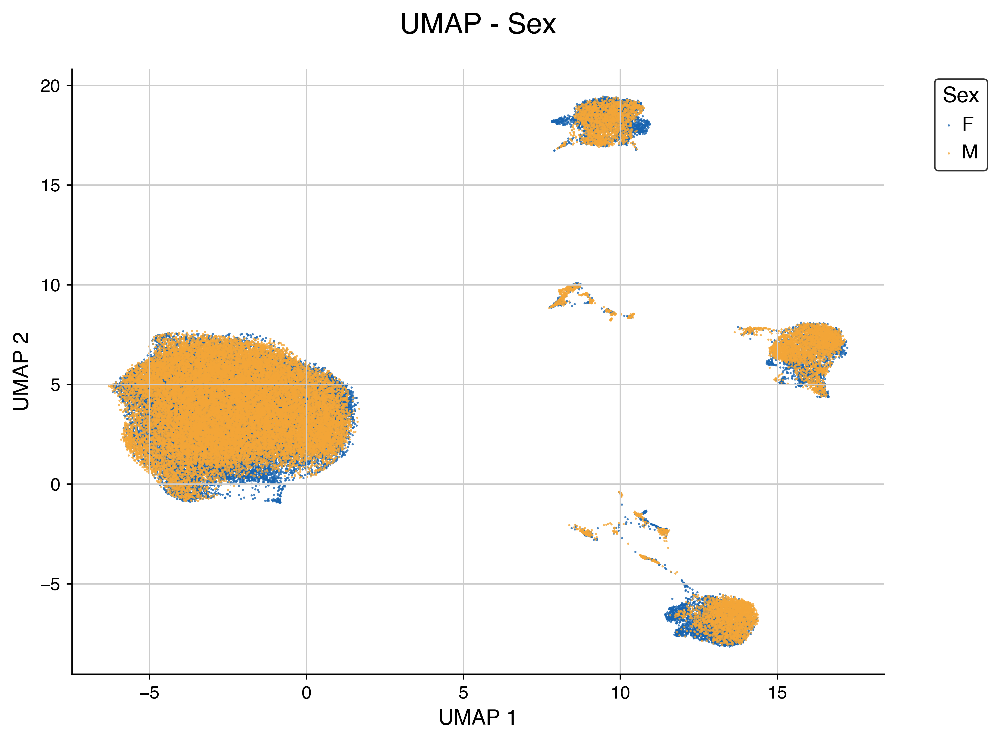

✓ Individual sex UMAP saved


1 extra bytes in post.stringData array
'created' timestamp seems very low; regarding as unix timestamp


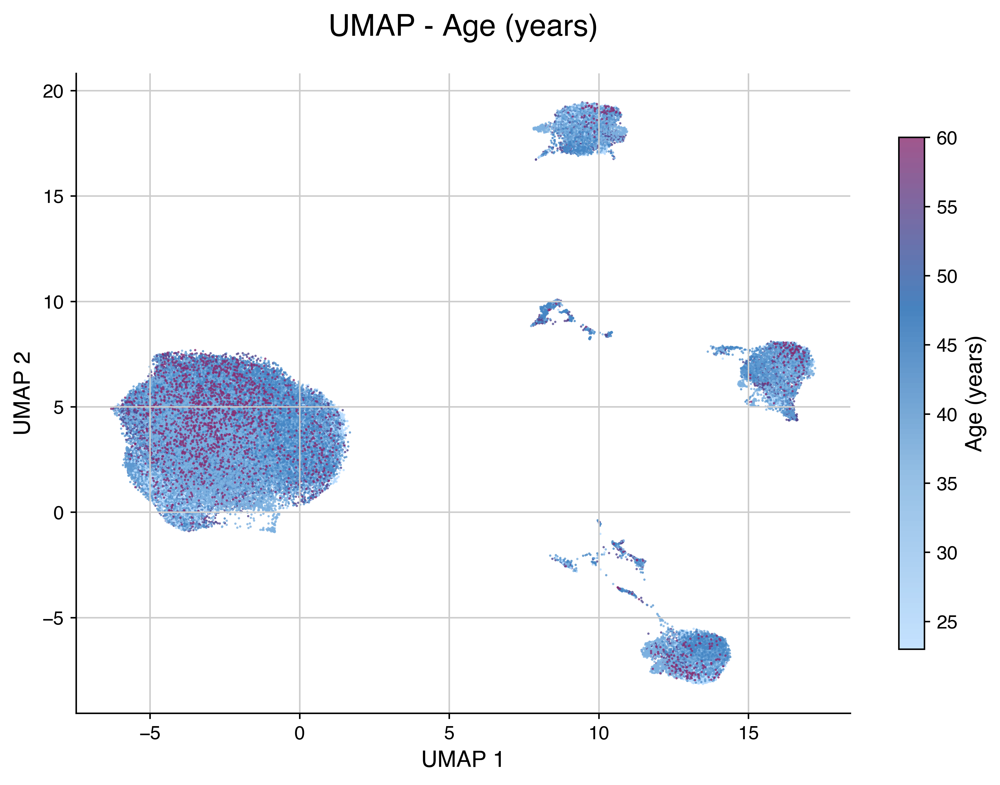

✓ Individual age UMAP saved


1 extra bytes in post.stringData array
'created' timestamp seems very low; regarding as unix timestamp


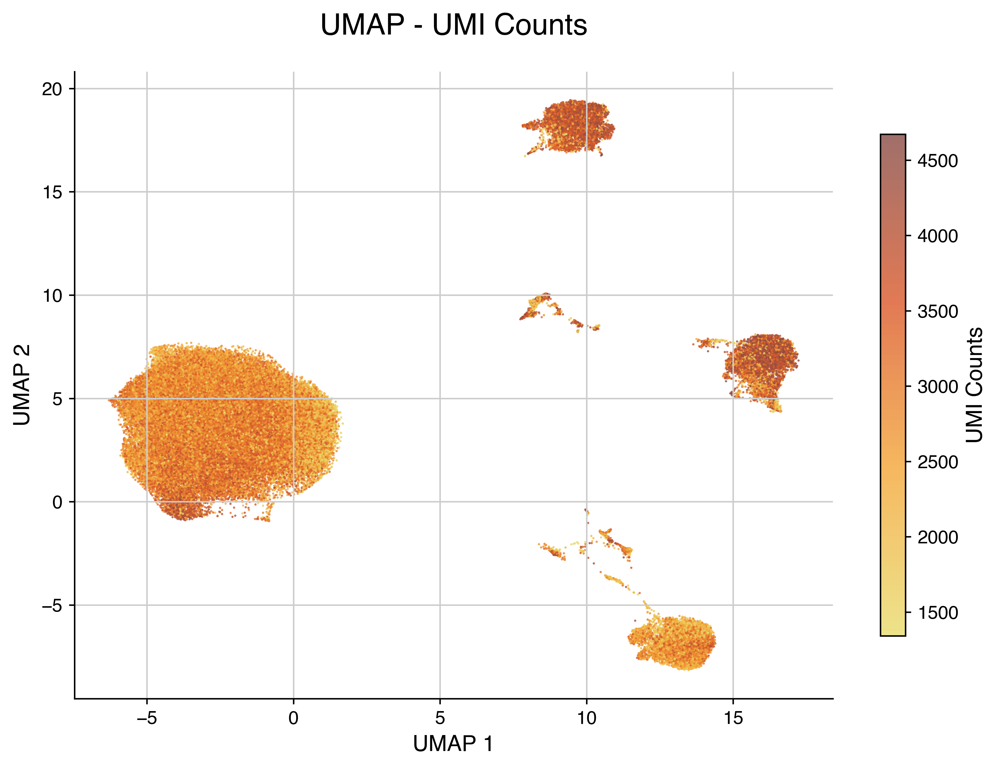

✓ Individual n_genes_by_counts UMAP saved

Creating metadata summary table...


1 extra bytes in post.stringData array
'created' timestamp seems very low; regarding as unix timestamp


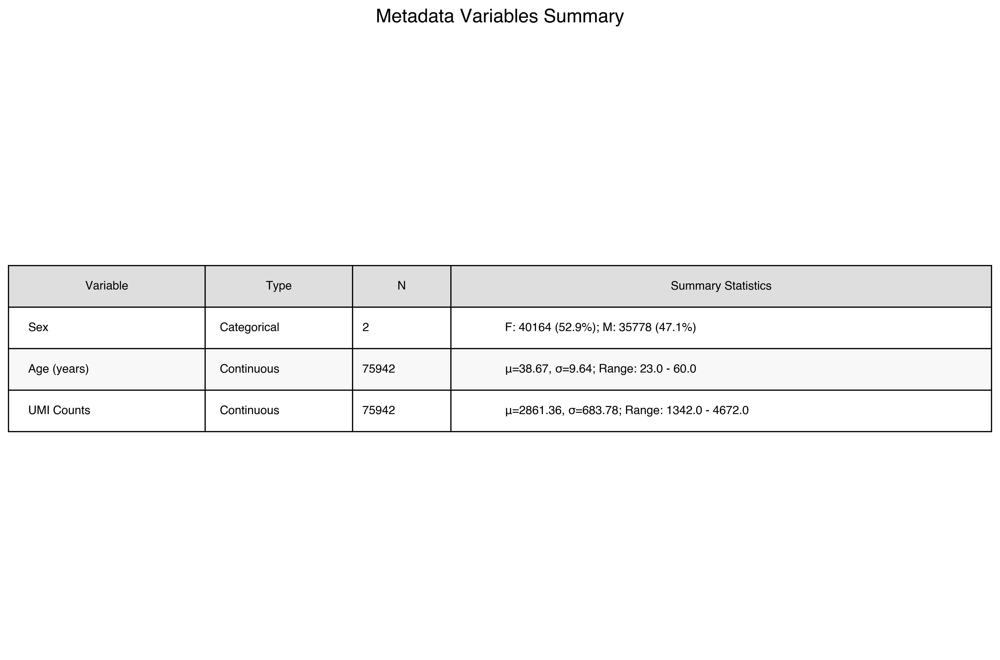

✓ Metadata summary table saved to /Users/aumchampaneri/Complement-OUD/Multi-Omics Study/figures/snrna/outputs

2️⃣ CREATING CELL TYPE UMAP VISUALIZATIONS
Creating cell type UMAP visualization...
Found 13 cell types:
  Microglia: 5,775 cells
  Oligodendrocytes: 58,693 cells
  OPCs: 4,883 cells
  Astrocytes: 5,277 cells
  Endothelial: 421 cells
  Pericytes: 166 cells
  D2_MSN: 292 cells
  PTHLH_Interneurons: 54 cells
  SST_Interneurons: 33 cells
  Mixed_MSN: 55 cells
  D1_MSN: 201 cells
  CCK_Interneurons: 20 cells
  Cholinergic_Interneurons: 72 cells


1 extra bytes in post.stringData array
'created' timestamp seems very low; regarding as unix timestamp


1 extra bytes in post.stringData array
'created' timestamp seems very low; regarding as unix timestamp


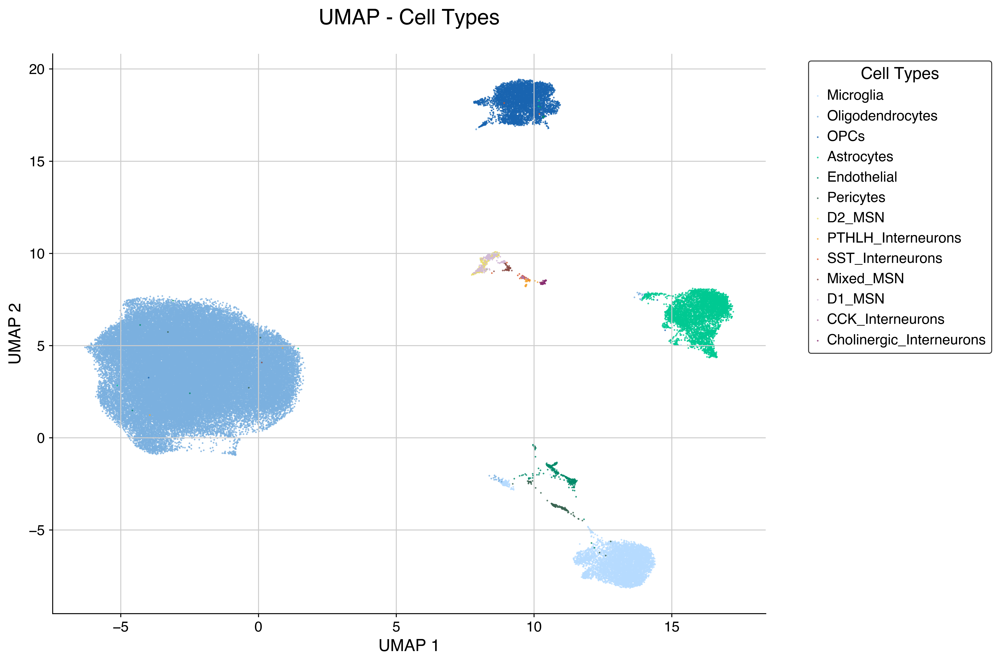

✓ Cell type UMAP visualizations saved to /Users/aumchampaneri/Complement-OUD/Multi-Omics Study/figures/snrna/outputs

3️⃣ CREATING QC METRICS UMAP VISUALIZATIONS
Creating quality control UMAP visualizations...
Available QC metrics:
  ✓ n_genes_by_counts
  ✓ total_counts
  ✓ pct_counts_mt
  ✓ pct_counts_ribo


1 extra bytes in post.stringData array
'created' timestamp seems very low; regarding as unix timestamp


✓ QC metrics UMAP visualization saved to /Users/aumchampaneri/Complement-OUD/Multi-Omics Study/figures/snrna/outputs

🎉 UMAP VISUALIZATION ANALYSIS COMPLETE!

📁 Generated Files:
  • PNG figures: 28
  • PDF figures: 27

📋 Key Output Files:
  ✓ ✓ Figure_UMAP_Metadata_Comprehensive
  ✓ ✓ Figure_UMAP_SEX
  ✗ ✗ Figure_UMAP_OUD_DIAGNOSIS
  ✓ ✓ Figure_UMAP_AGE
  ✓ ✓ Figure_UMAP_N_GENES_BY_COUNTS
  ✓ ✓ Figure_UMAP_CellTypes_Clean
  ✓ ✓ Figure_UMAP_QC_Metrics
  ✓ ✓ Figure_Metadata_Summary_Table

🎨 All figures use the custom color palette:
   • Nature journal best practices
   • Helvetica font
   • 300 DPI resolution
   • Vector-friendly formats
   • Colorblind-friendly colors

✅ UMAP visualization pipeline completed successfully!
   Files saved to: /Users/aumchampaneri/Complement-OUD/Multi-Omics Study/figures/snrna/outputs


In [5]:
# EXECUTE ALL UMAP VISUALIZATIONS
# =================================
# Run all UMAP visualization functions to generate comprehensive figures

print("🎯 Starting comprehensive UMAP visualization analysis...")
print(f"📊 Dataset: {adata.shape[0]:,} cells × {adata.shape[1]:,} genes")
print(f"📁 Output directory: {output_dir}")

# Check if UMAP coordinates exist
if 'X_umap' not in adata.obsm.keys():
    print("⚠ No UMAP coordinates found in data.")
    print("Available embeddings:", list(adata.obsm.keys()))
    print("Please ensure UMAP has been computed first.")
else:
    print("✓ UMAP coordinates found")
    
    # Display data summary
    print("\n📋 Data Summary:")
    print(f"  • Cells: {adata.n_obs:,}")
    print(f"  • Genes: {adata.n_vars:,}")
    print(f"  • Observations: {len(adata.obs.columns)}")
    print(f"  • Available obs columns: {list(adata.obs.columns)}")
    
    print("\n" + "="*60)
    print("1️⃣ CREATING METADATA UMAP VISUALIZATIONS")
    print("="*60)
    
    try:
        create_metadata_umaps(adata, output_dir)
    except Exception as e:
        print(f"❌ Error in metadata UMAPs: {e}")
        import traceback
        traceback.print_exc()
    
    print("\n" + "="*60)
    print("2️⃣ CREATING CELL TYPE UMAP VISUALIZATIONS")
    print("="*60)
    
    try:
        create_cell_type_umap(adata, output_dir)
    except Exception as e:
        print(f"❌ Error in cell type UMAPs: {e}")
        import traceback
        traceback.print_exc()
    
    print("\n" + "="*60)
    print("3️⃣ CREATING QC METRICS UMAP VISUALIZATIONS") 
    print("="*60)
    
    try:
        create_qc_umaps(adata, output_dir)
    except Exception as e:
        print(f"❌ Error in QC UMAPs: {e}")
        import traceback
        traceback.print_exc()
    
    print("\n" + "="*60)
    print("🎉 UMAP VISUALIZATION ANALYSIS COMPLETE!")
    print("="*60)
    
    # List generated files
    import glob
    png_files = glob.glob(f"{output_dir}/*.png")
    pdf_files = glob.glob(f"{output_dir}/*.pdf")
    
    print(f"\n📁 Generated Files:")
    print(f"  • PNG figures: {len(png_files)}")
    print(f"  • PDF figures: {len(pdf_files)}")
    
    print(f"\n📋 Key Output Files:")
    key_files = [
        "Figure_UMAP_Metadata_Comprehensive",
        "Figure_UMAP_SEX", 
        "Figure_UMAP_OUD_DIAGNOSIS",
        "Figure_UMAP_AGE",
        "Figure_UMAP_N_GENES_BY_COUNTS",
        "Figure_UMAP_CellTypes_Clean",
        "Figure_UMAP_QC_Metrics",
        "Figure_Metadata_Summary_Table"
    ]
    
    for filename in key_files:
        png_path = f"{output_dir}/{filename}.png"
        pdf_path = f"{output_dir}/{filename}.pdf"
        png_exists = "✓" if os.path.exists(png_path) else "✗"
        pdf_exists = "✓" if os.path.exists(pdf_path) else "✗"
        print(f"  {png_exists} {pdf_exists} {filename}")
    
    print(f"\n🎨 All figures use the custom color palette:")
    print("   • Nature journal best practices")
    print("   • Helvetica font")  
    print("   • 300 DPI resolution")
    print("   • Vector-friendly formats")
    print("   • Colorblind-friendly colors")
    
    print(f"\n✅ UMAP visualization pipeline completed successfully!")
    print(f"   Files saved to: {output_dir}")